# Notebook Overview

The following notebook reads data from the "Bias_correction_ucl.csv" file and reads the data as a pandas dataframe. The purpose of this notebook is to anlyze this data, preprocess it and build a machine learning pipeline to attach the problem of bias correction of LDAPS models to predict next day minimum and maximum temperatures (Next_Tmin & Next_Tmax)

The note book is divided in the following main sections:
1. Read Data: read the data as a pandas data frame
2. Explarotary Data Analysis: analysis of the data to get a better undestanding. For example, EDA contains exploring zero and missing values, show some statistical plots and correlation between variables. 
3. Data Preprocessing: this step takes care of removing missing values and put the data in the right format if necessary for further steps. At this step, an assumption is made that data during inference will not contain the same flaws which this step is taking care of. Hence, these steps were added as preprocessing steps and were not added directly to the machine learning pipeline. 

4. Data Segregation: the data is segregated here to training and test data sets, where the test data set contain data from the latest year (2017). This will lead to results that cannot be compared directly to the results of the referenced paper. However, this decision was taken becasue the hindcast validation introduced in the paper is computationally expensive, especially if it would be used for hyper-parameter tuning. Since hyper-parameter tuning is extensively used in this assigment, a yearly Hindcast validation was implemented to be used for hyper-parameter tuning and a test dataset is used for the final evaluation. 

5. Machine Learning Pipeline and Results: more details will be shown later in the notebook

**Python Version Used: 3.10.4**

In [1]:
# Main imports

import numpy as np

import pandas as pd
import pandas_profiling

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

from IPython.display import display

from typing import Union, Tuple

# Read Data

In [2]:
# Read data
df = pd.read_csv('Bias_correction_ucl.csv')

# Explarotary Data Analysis (EDA)

## Data Overview

In [3]:
# First 5 rows of the data
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


In [4]:
# Summary statistics
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7750.000000,7682.000000,7682.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,...,7677.000000,7677.000000,7677.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7725.000000,7725.000000
mean,13.000000,29.768211,23.225059,56.759372,88.374804,29.613447,23.512589,7.097875,62.505019,0.368774,...,0.485003,0.278200,0.269407,37.544722,126.991397,61.867972,1.257048,5341.502803,30.274887,22.932220
std,7.211568,2.969999,2.413961,14.668111,7.192004,2.947191,2.345347,2.183836,33.730589,0.262458,...,1.762807,1.161809,1.206214,0.050352,0.079435,54.279780,1.370444,429.158867,3.128010,2.487613
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,...,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000
25%,7.000000,27.800000,21.700000,45.963543,84.222862,27.673499,22.089739,5.678705,37.266753,0.146654,...,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.300000
50%,13.000000,29.900000,23.400000,55.039024,89.793480,29.703426,23.760199,6.547470,56.865482,0.315697,...,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000
75%,19.000000,32.000000,24.900000,67.190056,93.743629,31.710450,25.152909,8.032276,84.223616,0.575489,...,0.018364,0.007896,0.000041,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,...,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000


In [5]:
# Data dtypes
df.dtypes

station             float64
Date                 object
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

In [6]:
# Number of rows & cols
num_rows, num_cols = df.shape

# Columns with missing values
null_cols = set(df.columns[df.isnull().any()])

# Columns with no missing values
no_null_cols = set(df.columns) - null_cols

# Number of missing values in each column
null_size = df.isnull().sum()

print(f'The data has {num_rows} rows and {num_cols} columns\n')
print(f'The columns NOT containing missing values are: {no_null_cols}\n')
print(f'The number of missing values in each column:\n{null_size}')

The data has 7752 rows and 25 columns

The columns NOT containing missing values are: {'DEM', 'lat', 'Slope', 'lon', 'Solar radiation'}

The number of missing values in each column:
station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64


## Data Profiling

The following generates a comprehensive, quick, and interactive report about the data. It includes summary statistics about the data, histograms of individual variables, correlation matrix, and analysis of missing values. 

*Note*: during the EDA process, some steps that are generated by pandas_profiling will be generated manually again for a step by step analysis and explanation. 

In [7]:
profile = pandas_profiling.ProfileReport(df, explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Exploring Zeros

Columns who have >10% of the data as zeros are:
['LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4']


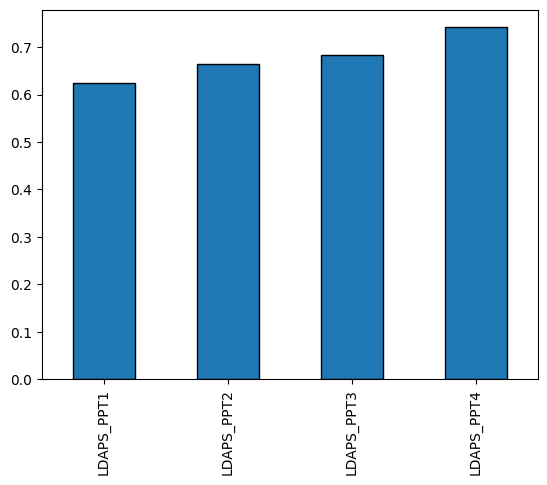

In [8]:
# Ratio of zeros in all columns
zero_ratios = (df == 0).mean()

# Columns who have 10% or more of their values as zero
high_zero_columns = list(df.columns[zero_ratios >= 0.1])

zero_ratios[high_zero_columns].plot(kind='bar', edgecolor='black')
print(f'Columns who have >10% of the data as zeros are:\n{high_zero_columns}')

More than 60% of the LDAPS model forecast of the 4 split average precipitation values are zeros. This suggests that these 4 columns could be removed from the data. However, later we will build a feature selector to choose the most discriminative features through cross-validation, this will prevent us from taking early decisions on removing features from the data. 

## Exploring Missing Values

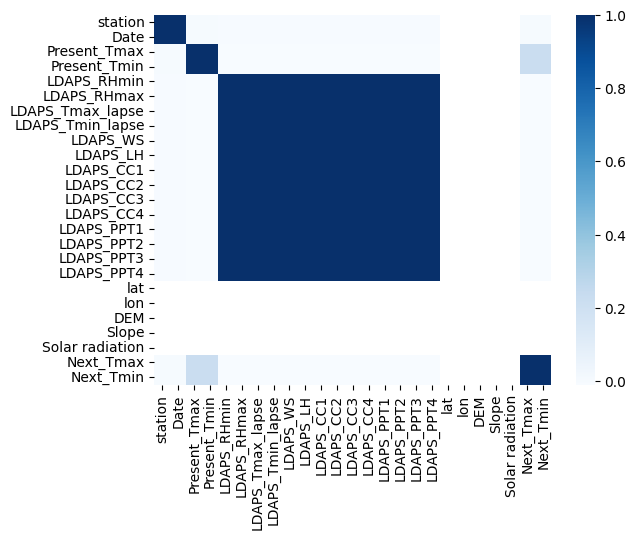

In [9]:
# Generate a heatmap for the correlation of the missing valus in the data
ax = sns.heatmap(df.isnull().corr(), cmap='Blues')

### Date and station

The Date and station columns have two missing values. The missing values correlation heatmap suggest that the missing values from both columns perfectly coincide with each other, however all the other variables have valid information for these two entities. Let's explore more to see where these missing values happen.

In [10]:
# The indices of the rows that have missing dates and stations
null_dates_rows = df[df['Date'].isnull()].index.to_list()
 
# The dates of the last 27 measurements 
last_27_dates = df.iloc[-27:]['Date'].value_counts()

print(f'The rows indices of the missing dates are: {null_dates_rows}, which are the last two rows\n')
print(f'The dates of the last 27 measurements are:\n{last_27_dates}')

The rows indices of the missing dates are: [7750, 7751], which are the last two rows

The dates of the last 27 measurements are:
2017-08-30    25
Name: Date, dtype: int64


The last 27 measurements contain only one date with 25 values. Hence, it is obvious that these missing information come from a new day for which only two measurements out of the 25 stations are available. This suggests the removal of these two entities. 

### In-situ Measurements & LDAPS Predictions 

The missing values correlation heatmap suggests that all the LDAPS missing values perfectly coincide with each other. The same is true for Present_Tmax & Present_Tmin (in-situ observations). However, missing values from in-situ observations and LDAPS predictions never coincide. 

Next it would be helpful to know from which dates and stations are these values missing to have a better understanding if there is a pattern in the nature of the missing values. 

In [11]:
# Dates which contain missing values for Present_Tmax and Present_Tmin
null_insitu_dates = df[df['Present_Tmax'].isnull()].groupby('Date').size()

# Stations which contain missing values for Present_Tmax and Present_Tmin
null_insitu_stations = df[df['Present_Tmax'].isnull()].groupby('station').size()

# Dates which contain missing values from the LDAPS model predictions
null_LDAPS_dates = df[df['LDAPS_Tmax_lapse'].isnull()].groupby('Date').size()

# Stations which contain missing values from the LDAPS model predictions
null_LDAPS_stations = df[df['LDAPS_Tmax_lapse'].isnull()].groupby('station').size()

print(f'The number of days that do not have in-situ observation values are: {null_insitu_dates.size}')
print(f'The number of stations that do not have in-situ observation values are: {null_insitu_stations.size}\n')

print(f'The number of days that do not have LDAPS prediction values are: {null_LDAPS_dates.size}')
print(f'The number of stations that do not have LDAPS prediction values are: {null_LDAPS_stations.size}')

The number of days that do not have in-situ observation values are: 56
The number of stations that do not have in-situ observation values are: 19

The number of days that do not have LDAPS prediction values are: 3
The number of stations that do not have LDAPS prediction values are: 25


The answer to the previous questions suggest that the missing in-situ measurements happen at random times from different stations. However, the missing LDAPS values are missing from only 3 days but from all the stations.

### Target Variables

The missing values heatmap shows that the missing values of both target variables coincide perfectly with each other. In addition, these missing values also correlate with the in-situ measurement values.

In [12]:
# Dates which contain missing target variables which don't coincide with missing in-situ measurements
null_target_dates = df[df['Next_Tmax'].isnull() & ~df['Present_Tmax'].isnull()].groupby('Date').size()

# Stations which contain missing target variables which don't coincide with missing in-situ measurements
null_target_stations = df[df['Next_Tmax'].isnull() & ~df['Present_Tmax'].isnull()].groupby('station').size()

print(f'The number of days that do not have target values are: {null_target_dates.size}')
print(f'The number of stations that do not have target values are: {null_target_stations.size}')

The number of days that do not have target values are: 16
The number of stations that do not have target values are: 11


## Temperature Densities

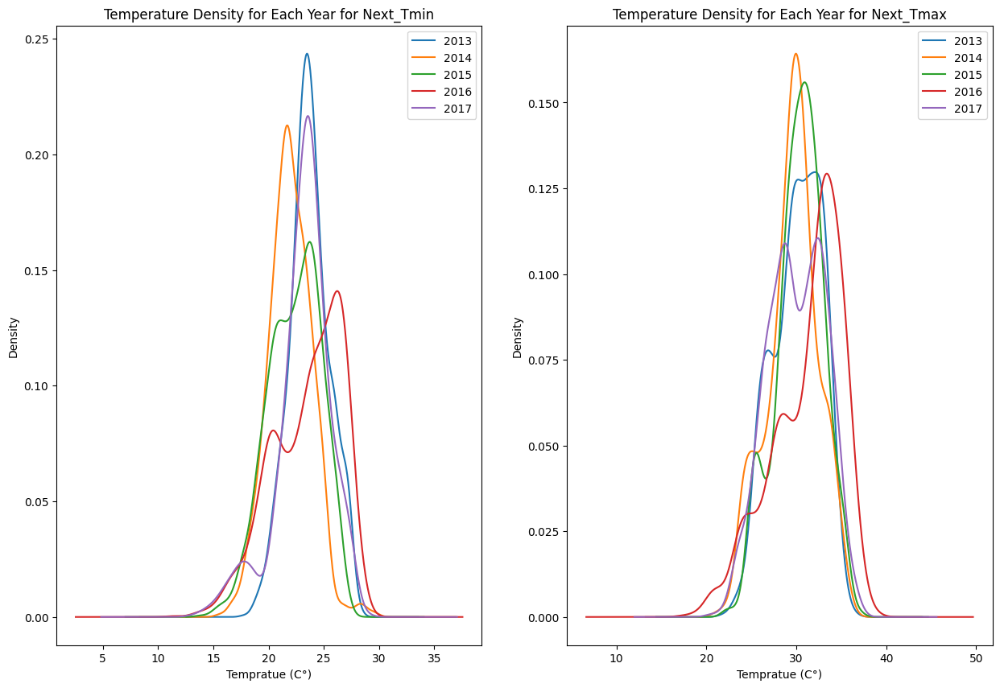

In [13]:
# Plot temperature densities to show if there are changes across the years
fig, ax = plt.subplots(1, 2, figsize=(15, 10))

for i, temp in enumerate(['Next_Tmin', 'Next_Tmax']):
    df.groupby(df['Date'].apply(pd.to_datetime).dt.year)[temp].plot(kind='density', ax=ax[i])
    
    ax[i].legend(['2013', '2014', '2015', '2016', '2017'])
    ax[i].set_title(f'Temperature Density for Each Year for {temp}')
    ax[i].set_xlabel(f'Tempratue (C°)')

## Variables Correlation Matrix 

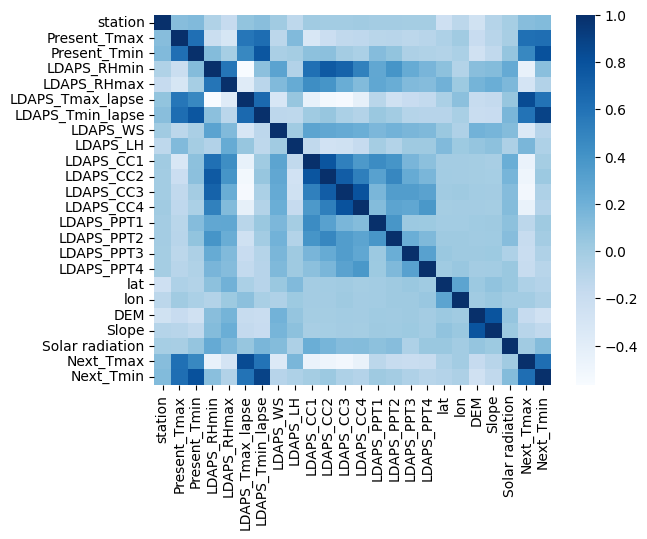

In [14]:
ax = sns.heatmap(df.corr(), cmap='Blues')

## Variables Histograms

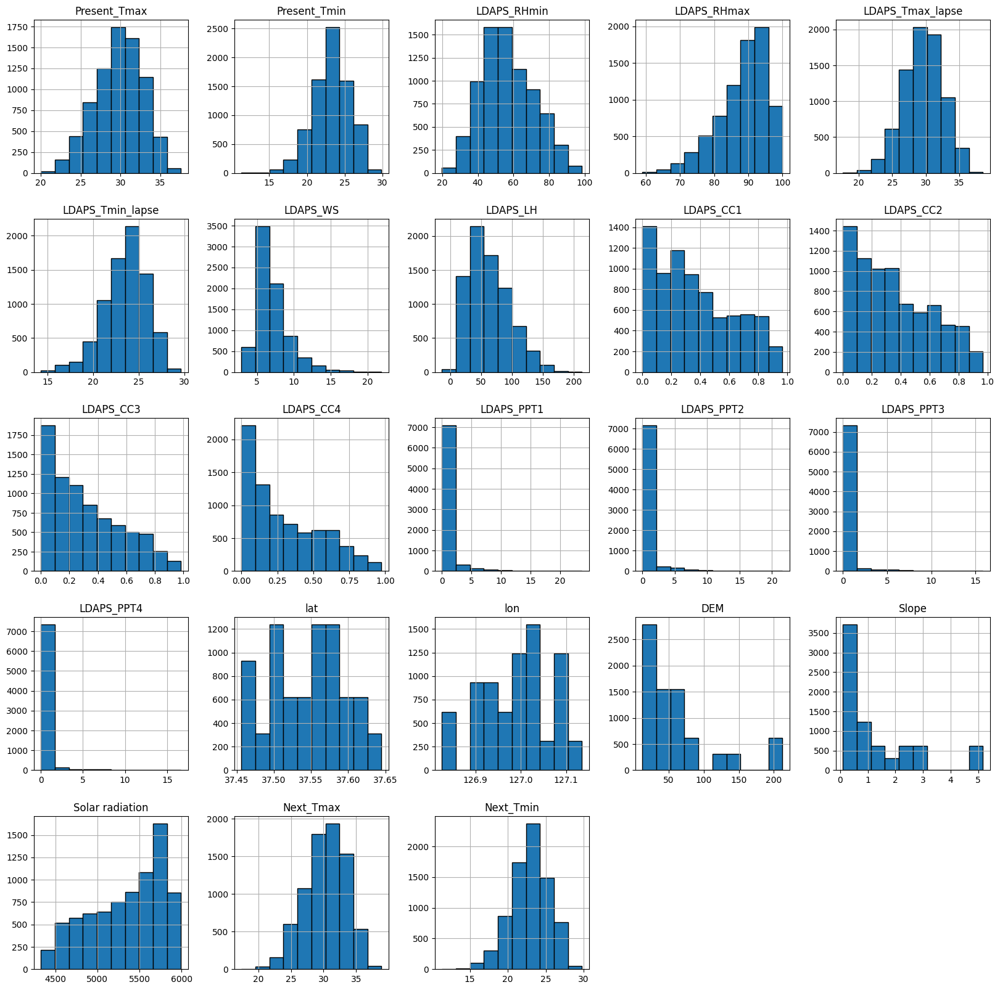

In [15]:
fig = df.loc[:, ~df.columns.isin(['station'])].hist(edgecolor='black', figsize=(20,20))

## Years Bar Plot

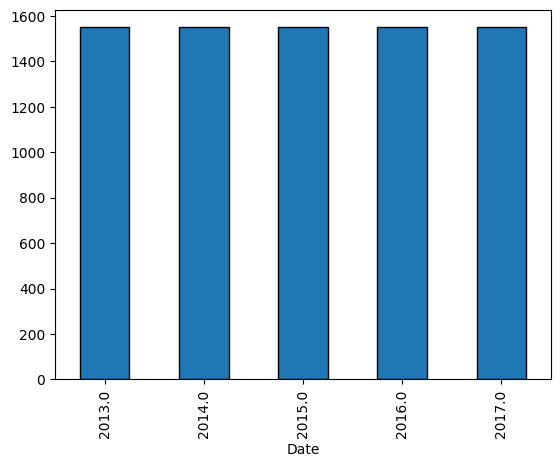

In [16]:
# Check the data distribution across the years
years = df.groupby(df['Date'].apply(pd.to_datetime).dt.year).size().plot(kind='bar', edgecolor='black')

## Months Bar Plot

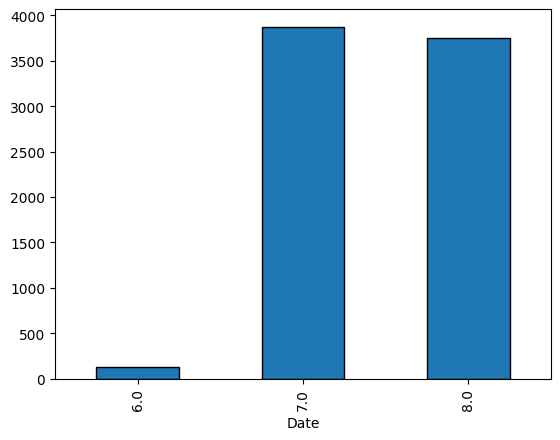

In [17]:
# Check the data distribution across the months
years = df.groupby(df['Date'].apply(pd.to_datetime).dt.month).size().plot(kind='bar', edgecolor='black')

## Coordinates Bar Plot

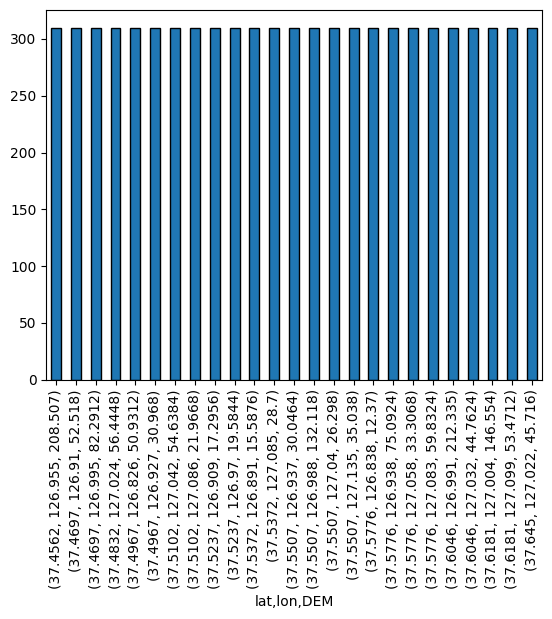

In [18]:
# Group by coordinates and remove the last two rows that contain missing station numbers
coordinates = df.iloc[:-2].groupby(['lat', 'lon', 'DEM']).size().plot(kind='bar', edgecolor='black')

The coordinates group into 25 groups that distribute unifromly across the days, which means that one can use these coordinates to describe the location of the 25 stations. Hence, the station variable can be removed from the data and maybe used as an index.

# Data Preprocessing

In [19]:
def preprocess_data(df: pd.DataFrame) -> Tuple[pd.DataFrame, pd.DataFrame]:
    """Function that takes as input the raw data of Bias_correction_ucl.csv as a dataframe, 
    applies steps of preprcoessing and cleaning, then returns the independent and dependent (target) variables 
    in separate dataframes. 
    
    Preprocessing steps are:
        1. Remove the last two rows because they have missing data and station numbers
        2. Remove all rows that have missing target variables
        3. Remove all rows that have missing in-situ measurements
        4. Remove all rows that have missing LDAPS measurements
        5. Convert the data from string into datetime format, and the station from float into int
        6. Set Date and station as a multi-index of the data and extract target variables
        
    Args:
        df: dataframe of the raw data
        
    Returns: X, y as independent and dependent variables, respectively
    
    """
    
    target_vars = ['Next_Tmin', 'Next_Tmax']
    
    # Step 1
    df = df.iloc[:-2]
    
    # Step 2 - Step 4 can be done in one step since we are considering all the columns that have Null values
    df = df.dropna(axis=0, how='any')
    
    # Step 5
    df['Date'] = pd.to_datetime(df['Date'])
    df['station'] = df['station'].apply(int)
    
    # Step 6
    df = df.set_index(['Date', 'station'])
    
    X, y = df.drop(target_vars, axis=1), df[target_vars]
    
    return X, y

# Apply data preprocessing
X, y = preprocess_data(df)

# Data Validation

In [20]:
# Test the number of columns
assert len(X.columns) == 21 # 25 - 2(target variables) - 2(Date & station)
assert len(y.columns) == 2 # Next_Tmin & Next_Tmax

# Test the number of rows
assert X.shape[0] == y.shape[0] 

# Test type of the Data index
assert type(X.index.get_level_values(0)) == pd.core.indexes.datetimes.DatetimeIndex

# Test if there are no Null values
assert  X.isnull().all(axis=0).all() == False

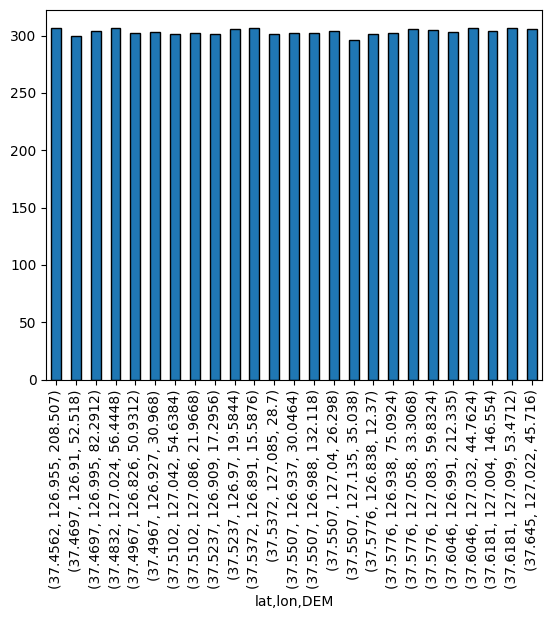

In [21]:
# Visualize the distribution of the station after removing Nulls
coordinates = X.iloc[:-2].groupby(['lat', 'lon', 'DEM']).size().plot(kind='bar', edgecolor='black')

The distribution of the stations after removing Null values is not uniform anymore. This means that some stations are represented more than the others. This needs to be taken in consideration when the evaluation results are interpreted. 

# Data Segregation

The data here will be segregated into train and test sets, where the test set contains data from the latest year (2017). 
It is important to note here that this kind of evaluation is biased to some extent since the models will be only evaluated on a specific year. 

For better evaluation, one could evaluate the data in a time-based cross-validation manner, however this kind of validation in this assignment will be used for hyper-parameter tuning. 

As an improvement and in an attempt to combine both, one could implement a nested cross-validation where in each split the data is divided into train, validation, and test in a time-based manner. In this case one could evaluate the data on different time sequences and still be able to hyper-paramter tune the ML models without data leackage. However, for this assignment the models will be evaluated on the test set while cross-validation will be used for tuning the hyper-parameters.

In [22]:
def train_test_split(X: pd.DataFrame, y: pd.DataFrame) -> Tuple[pd.DataFrame]: 
    years_groups = X.groupby(X.index.get_level_values(0).year).size()

    # Extract the last year as test set, and assign the rest as train set
    train_idxs = np.where(X.index.get_level_values(0).year != years_groups.index[-1])
    test_idxs = np.where(X.index.get_level_values(0).year == years_groups.index[-1])
    
    X_train = X.iloc[train_idxs]
    y_train = y.iloc[train_idxs]
    
    X_test = X.iloc[test_idxs]
    y_test = y.iloc[test_idxs]
    
    return X_train, y_train, X_test, y_test

# Apply data segregation
X_train, y_train, X_test, y_test = train_test_split(X, y)

# Feature Importance & Dimensionality Reduction

This step is made to have a better understanding of the features we have in the training data and what features could be contributing best to the ML models. This will also help to decide if dimensionality reduction or feature selection will be required in the pipeline. 

It is important to note here that this step will not apply feautre selection or dimensionality reduction yet. These steps, if necessary, will be added as part of the ML pipeline to prevent any data leackage during cross-validation and testing. 

In [23]:
from sklearn.feature_selection import r_regression, mutual_info_regression
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler

## Mutual Information

Mutual information between independent variables and target variables gives an idea which features are the most discriminative ones for these target variables.

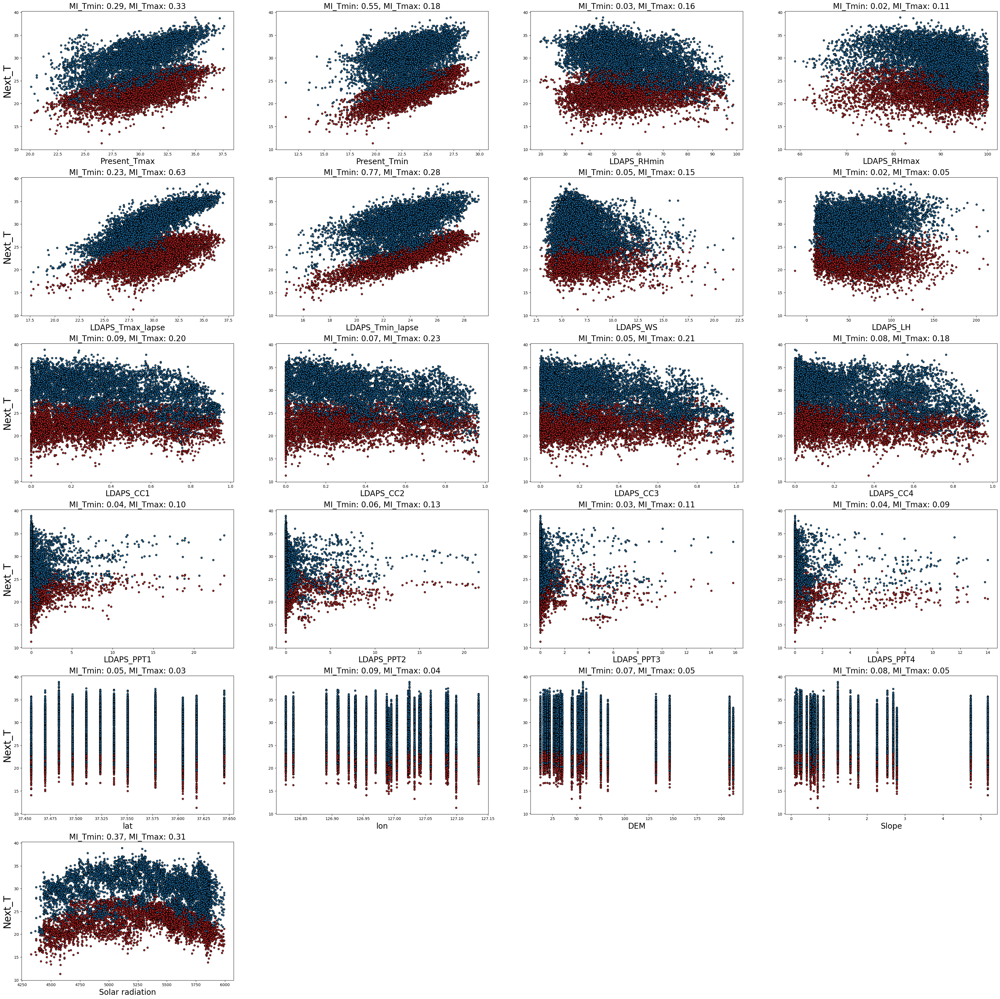

In [24]:
# Mutual information between each feature in X_train and the Next_T (Next_Tmin & Next_Tmax)
mi_Tmin = mutual_info_regression(X_train, y_train['Next_Tmin'])
mi_Tmax = mutual_info_regression(X_train, y_train['Next_Tmax'])

fig = plt.figure(figsize=(45,45))
for i in range(21):
    ax = plt.subplot(6, 4, i + 1)
    
    # Scatter plot
    ax.scatter(X_train.iloc[:, i], y_train['Next_Tmin'], color='tab:red',
               edgecolor="black", s=20, label='Next_Tmin')
    
    ax.scatter(X_train.iloc[:, i], y_train['Next_Tmax'], color='tab:blue',
               edgecolor="black", s=20, label='Next_Tmax')

    # xlabel
    ax.set_xlabel(f'{X.columns[i]}', fontsize=20)
    
    # ylabel every row
    ax.set_ylabel('Next_T', fontsize=25) if i % 4 == 0 else None
        
    ax.set_title(f'MI_Tmin: {mi_Tmin[i]:0.2f}, MI_Tmax: {mi_Tmax[i]:0.2f}', fontsize=20)

Mutual information ranks LDAPS_Tmin_lapse and Present_Tmin feature as the most discriminative features for Next_Tmin. Solar radiation, Present_Tmax, and LDAPS_Tmax_lapse come next. The other feature have small mutual infromation with the target variable, which suggest feature selection techniques are required to add to the pipeline. 

## Principal Component Analysis (PCA)

Instead of selecting the features according to a feature importance measure, we could project the data into another dimensional system where a less number of features can be used. Let' see if we would use PCA for that, how many features we could use to maintain at least 95% of the variance of the data.

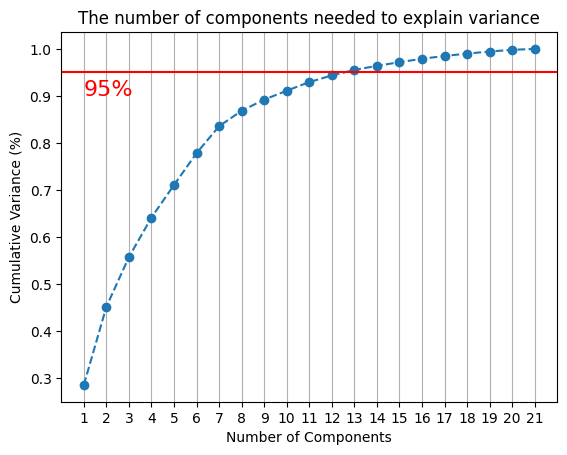

In [25]:
# Rescale the data between 0 and 1
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)

# Apply PCA
pca = PCA().fit(X_train_scaled)

# Find the cumulative variance explained by PCA components
cum_var = np.cumsum(pca.explained_variance_ratio_)

# Creat figure
fig, ax = plt.subplots()

# Figure x-axis
num_comp = np.arange(1, 22)

# Plot cumulative variance vs. number of components
plt.plot(num_comp, cum_var, marker='o', linestyle='--')

# Add labels and title
plt.xticks(np.arange(1, 22)) 
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Variance (%)')
plt.title('The number of components needed to explain variance')

# Draw a horizontal line 
plt.axhline(y=0.95, color='r', linestyle='-')
plt.text(1, 0.9, '95%', color='red', fontsize=16)

# Draw grid
ax.grid(axis='x')

We would need 13 PCA components to explain 95% of the data's variance.

Even though this would help in reducing the number of features, in the pipeline we will stick to feature selection instead of dimensionality reduction because this will help keep the interpretibility of the features when the ML models are analyzed. 

# Machine Learning Pipeline

The machine learning pipeline consists of a transformer and 6 machine learning models. The transfomrer pipeline consists of standarditation followed by feature selection using the coefficients from a linear regression model fitted to the data. 

The machine learning models are:
1. Linear Regression
2. Random Forest
3. Gradient Boosting
4. Support Vector Regression
5. Multi-layer Perceptron
6. Multi-model Ensemble that either takes a uniform-average of given models OR uses a given estimator to learn how to combine the output of the given models

The pipeline also uses yearly Hindcast validation to tune the hyper-parameters of the machine learning models. The Hindcast validation uses the R2 score to decide on the final hyper-parameters. The average R2 score is taken over both target variables Next_Tmin & Next_Tmax. 

The final evaluation is taken on the test dataset which contains the data from the last year (2017). The metrics uses for evaluation are: R2 score (coefficient of determination), Bias, RMSE (Root Mean Squared Error), and Skill Score which compares the RMSE of both, the machine learning model and the LDAPS model.

The following cells are mainly divided into the following:
- Custom Metrics: metrics that are used for evaluation.
- Custom Validation Functions: Hindcast validation and Leave-One-Station-Out validation (LOSOCV). Note: The LOSOCV is not used in this assignment for due to its relative computation time. 
- Modeling Functions: consists of two funcitons: build_regression_pipeline and evaluate 
- Transformer & Machine Learning Models: for each mentioned model there is a training step and an evaluation step. For some models there is also analysis of feature importances.
- Results: shows two types of plots (4 plots in total):
    1. Two plots for forecasted temperatures vs. observed temperatures for each model. One plot for Next_Tmin and the other for Next_Tmax
    2. Two plots for skill score evaluation per weather station. One plot for Next_Tmin and the other for Next_Tmax
    
**Note: The run time of the folowing cells takes around 10 minutes on MSI Stealth GS66, Intel Core i9-12. No GPU computation was utilized.** 

In [26]:
from sklearn.base import RegressorMixin, TransformerMixin

from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV

from sklearn.metrics import mean_squared_error, r2_score, make_scorer

## Custom Metrics

In [27]:
# Bias
def bias_metric(y_true: Union[np.ndarray, pd.DataFrame],
                y_pred: Union[np.ndarray, pd.DataFrame]) -> np.ndarray:
    
    """A function that implements the Bias metric
    
     Args:
        y_true: the ground truth Next_Tmin & Next_Tmax
        y_pred: the predicted Next_Tmin & Next_Tmax
        
    Returns: 
        Bias metric for each target variable
        
    """
    
    if isinstance(y_true, pd.DataFrame):
        y_true = y_true.values
        
    if isinstance(y_pred, pd.DataFrame):
        y_pred = y_pred.values
        
    return (y_pred - y_true).mean(axis=0)


# R Squared
def r2_metric(y_true: Union[np.ndarray, pd.DataFrame],
              y_pred: Union[np.ndarray, pd.DataFrame]) -> np.ndarray:
    
    """A wrapper function around the r2_score metric
    
    Args:
        y_true: the ground truth Next_Tmin & Next_Tmax
        y_pred: the predicted Next_Tmin & Next_Tmax
        
    Returns: 
        R2 metric for each target variable
    
    """
        
    return r2_score(y_true, y_pred, multioutput='raw_values', force_finite=False)


# Root Mean Square Error
def rmse_metric(y_true: Union[np.ndarray, pd.DataFrame],
                y_pred: Union[np.ndarray, pd.DataFrame]) -> np.ndarray:
    
    """A wrapper function around the mean_squared_error metric
    
     Args:
        y_true: the ground truth Next_Tmin & Next_Tmax
        y_pred: the predicted Next_Tmin & Next_Tmax
        
    Returns: 
        RMSE metric for each target variable
        
    """
        
    return mean_squared_error(y_true, y_pred, multioutput='raw_values', squared=False)


# Skill Score
def ss_metric(y_true: Union[np.ndarray, pd.DataFrame],
              y_pred_ldaps: Union[np.ndarray, pd.DataFrame],
              y_pred_ml: Union[np.ndarray, pd.DataFrame]) -> np.ndarray:
    
    """ A function to calculate the skill score by comparing the predictions of the machine learning model
    with the predictions of the LDAPS model.
       
    Args:
        y_true: ground truth Next_Tmin & Next_Tmax
        y_pred_ldaps: LDAPS predictions
        y_pred_ml: machine learning model predictions
           
    Returns:
        skill score for each target variable, which is the precentage decrease of RMSE between
        LDAPS and the machine learning model
       
    """
    
    rmse_ldaps =  rmse_metric(y_true, y_pred_ldaps)
    rmse_ml = rmse_metric(y_true, y_pred_ml)
    
    return (rmse_ldaps - rmse_ml) / rmse_ldaps * 100
        

## Custom Validation Functions

In [28]:
class HindcastCV:
    """A class that implements Hincast validation on a yearly basis 
    
    Unlike what is mentioned in the paper, this class applies Hindcast validation yearly, instead of daily. 
    The reason behind that is the need of a more efficient fuction in order to allow hyper-parameter tuning of
    the ML models. In additon, the data was taken only on summer over 5 years, which makes this function suitable
    for evaluating the generalization of the ML models across the years. 
    
    This class implements a generator that yields the train and test indices of different splits.

    """
    
    def split(self, X: pd.DataFrame, *args):
        """This method generates indices of train and test sets after splitting the data into successive years.
        At each split, the train set contains measurements from the firt year until the year that meets
        the current split, wheras the test set contains measurment from the next year. 
        The last year is only included in the test set.
        
        The method assumes a pandas dataframe as input with a multi-index, where the first index is the
        date in the datetime format.
        
        Args:
            X: data of independent variables
        
        """
        
        # Find the group of years and the number of measurements for each year
        years_groups = X.groupby(X.index.get_level_values(0).year).size()
        
        # Accumlative train size increses with each split
        train_size = 0 
        
        for split, (year, year_size) in enumerate(years_groups.items()):
            train_size += year_size  # train_size - 1 = row index of last training sample
            
            train_idx = np.arange(train_size)  
            test_idx = np.where(X.index.get_level_values(0).year == year + 1)[0]
                    
            if split == len(years_groups) - 1:
                break
            
            yield train_idx, test_idx
           
    def get_n_splits(self, X: pd.DataFrame, *args) -> int:
        years_groups = X.groupby(X.index.get_level_values(0).year).size()

        return len(years_groups) - 1

            
class LOSOCV:
    """A class that implements Leave-One-Station-Out validation, which can be used to test the generalization
    of the ML models across weather stations.
    
    This class implements a generator that yields the train and test indices of different splits.
    
    """
    
    def split(self, X: pd.DataFrame, *args):
        """This method generates indices of train and test sets after splitting the data into different
        stations. At each split, the test set contains measurements from a unique station across all years, 
        whereas the train set contains the measurements from all other stations. 
        
        The method assumes a pandas dataframe as input with a multi-index, where the second index is the 
        station number.
        
        Args:
            X: data of independent variables 
        
        """
        
        # Find the group of stations and the number of measurements for each station
        stations_groups = X.groupby(X.index.get_level_values(1)).size()
        
        for station, _ in stations_groups.items():
            train_idx = np.where(X.index.get_level_values(1) != station)[0]
            test_idx = np.where(X.index.get_level_values(1) == station)[0]
            
            yield train_idx, test_idx
            
    def get_n_splits(self, X: pd.DataFrame, *args) -> int:
        stations_groups = X.groupby(X.index.get_level_values(1)).size()
        
        return len(stations_groups)

## Modeling Functions

In [29]:
def build_regression_pipeline(transformer: Union[TransformerMixin, Pipeline],
                              regressor: RegressorMixin,
                              params: dict,
                              regressor_name: str = 'regressor') -> GridSearchCV:
    
    """A function that chains a given transformer with a given regressor to create a regression pipeline. 
    
    The function adds the contructed pipeline to GridSearchCV for tuning the hyper-parameters given by
    params. The returned GridSearchCV object uses the custom HindcastValidation. For choosing the best
    parameters, the funciton uses r2_score metric which averages the score over both target variables. 
    
    Args:
        transformer: a transformer instance or a pipeline
        regressor: a regression model that is fit to the data
        params: hyper-parameters to be tuned.
        regressor_name: name of the regressor to be used in the pipeline.
        n_jobs: number of jobs to be used in grid search
        
    Returns:
        An instance of GridSearchCV that can be used to fit a dataset
    
    """
    
    # Chain transformer pipeline with the regressor
    pipeline = Pipeline(steps=[
        ('transformer', transformer),
        (regressor_name, regressor)
    ])
    
    # Create a GridSearch object with HindacastCV and r2_score
    cv = GridSearchCV(pipeline, 
                      param_grid=params,
                      scoring=make_scorer(r2_score),
                      cv=HindcastCV,
                      verbose=3)
    
    return cv


def evaluate(model: Union[RegressorMixin, GridSearchCV],
             X_test: pd.DataFrame,
             y_test: pd.DataFrame,
             ml_model_name: str = 'model') -> Tuple[pd.DataFrame, np.ndarray]:
    
    """A function that evaluates a given inference pipeline contained in a GridSeachCV object
    on the given test data. The function also accepts any RegressorMixin model with have a predict method.
    
    The function calls the fit method of the pipeline on X_test, and then it calculates the three metrics:
    Bias, R2, and RMSE for the LDAPS model and the machine learning model. The results are returned
    in a dataframe. 
    
    The function also returns the skill score metric for both target variables. 
    
    X_test is assumed to include the two columns named LDAPS_Tmin_lapse and LDAPS_Tmax_lapse
    
    Args:
        model: inference pipeline contained in a GridSeachCV object
        X_test: test data containing independent variables
        y_test: ground truth test Next_Tmin & Next_Tmax
        
    Returns: 
        df: dataframe contains the Bias, R2, and RMSE metric results for both Next_Tmin and Next_Tmax
        ss_: the skill score metric for both Next_Tmin and Next_Tmax
        y_pred_ldaps: the LDAPS results contained in X_test
        y_pred_ml: the model predictions
        
    """
    
    # Assert the LDAPS temperature predictions exist in X
    assert set(['LDAPS_Tmin_lapse', 'LDAPS_Tmax_lapse']).issubset(X.columns)
    
    # Machine learning inference
    y_pred_ml = model.predict(X_test)
    
    # LDAPS predictions
    y_pred_ldaps = X_test[['LDAPS_Tmin_lapse','LDAPS_Tmax_lapse']]
    
    # Calculate Bias of both models
    bias_ldaps = bias_metric(y_test, y_pred_ldaps)
    bias_ml = bias_metric(y_test, y_pred_ml)
    bias_ = np.stack((bias_ldaps, bias_ml)).T.ravel()  # Concat models (ldaps_Tmin, ml_Tmin, ldaps_Tmax, ml_Tmax)
    
    # Calculate R2 of both models
    r2_ldaps = r2_metric(y_test, y_pred_ldaps)
    r2_ml = r2_metric(y_test, y_pred_ml)
    r2_ = np.stack((r2_ldaps, r2_ml)).T.ravel()  # Concat models (ldaps_Tmin, ml_Tmin, ldaps_Tmax, ml_Tmax)
    
    # Calculate RMSE of both models
    rmse_ldaps = rmse_metric(y_test, y_pred_ldaps)
    rmse_ml = rmse_metric(y_test, y_pred_ml)
    rmse_ = np.stack((rmse_ldaps, rmse_ml)).T.ravel()  # Concat models (ldaps_Tmin, ml_Tmin, ldaps_Tmax, ml_Tmax)
    
    # Create a multi-index column where first level is Tmin & Tmax, and second level is model
    columns = pd.MultiIndex.from_product([['Tmin', 'Tmax'], ['LDAPS', ml_model_name]])
    index = ['Bias', 'R2', 'RMSE']
    
    # Stack the results in a dataframe
    df = pd.DataFrame(np.stack((bias_, r2_, rmse_)), columns=columns, index=index)
    
    # Calculate SS
    ss_ = ss_metric(y_test, y_pred_ldaps, y_pred_ml)
    
    return df, ss_, y_pred_ml

## Transformers & * Machine Learning Models

### Transformers

The transformation steps that will be added to the pipeline are standardization and feature selection. Composing these into a pipeline helps in ensuring that there is NO data leackage from validation sets or test sets into training sets. Feature selection is done according to the feature importances achieved by the coefficients of a LinearRegression model fitted to the data at each split.

In [30]:
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectFromModel

from sklearn.linear_model import LinearRegression

In [31]:
# Create a pipeline with two transformers: standardization and feature selection 
transformer_pipeline = Pipeline(steps=[
    ('scaler', StandardScaler()),
    ('feature_selector', SelectFromModel(LinearRegression(), threshold=-np.inf))
])

print(f'The transformer pipeline consists of the following steps:\n{transformer_pipeline.steps}')

The transformer pipeline consists of the following steps:
[('scaler', StandardScaler()), ('feature_selector', SelectFromModel(estimator=LinearRegression(), threshold=-inf))]


### * Linear Regression

In [32]:
from sklearn.linear_model import Ridge

#### Training

In [33]:
# Hyper-parameters
params_LR = {
    'transformer__feature_selector__max_features': (13, 14, 15, 17),
}

# Create the model pipeline
cv_LR = build_regression_pipeline(transformer_pipeline, 
                                  Ridge(alpha=1),
                                  params=params_LR,
                                  regressor_name='LR')

# Fit the pipeline to training data
cv_LR.fit(X_train, y_train)

# Print pipeline and chosen parameters
display(cv_LR)
print(f'Parameters chosen by Hindcast validation:\n{cv_LR.best_params_}')

Fitting 3 folds for each of 4 candidates, totalling 12 fits
[CV 1/3] END transformer__feature_selector__max_features=13;, score=0.605 total time=   0.0s
[CV 2/3] END transformer__feature_selector__max_features=13;, score=0.723 total time=   0.0s
[CV 3/3] END transformer__feature_selector__max_features=13;, score=0.862 total time=   0.0s
[CV 1/3] END transformer__feature_selector__max_features=14;, score=0.602 total time=   0.0s
[CV 2/3] END transformer__feature_selector__max_features=14;, score=0.727 total time=   0.0s
[CV 3/3] END transformer__feature_selector__max_features=14;, score=0.862 total time=   0.0s
[CV 1/3] END transformer__feature_selector__max_features=15;, score=0.586 total time=   0.0s
[CV 2/3] END transformer__feature_selector__max_features=15;, score=0.723 total time=   0.0s
[CV 3/3] END transformer__feature_selector__max_features=15;, score=0.863 total time=   0.0s
[CV 1/3] END transformer__feature_selector__max_features=17;, score=0.589 total time=   0.0s
[CV 2/3] E

GridSearchCV(cv=<class '__main__.HindcastCV'>,
             estimator=Pipeline(steps=[('transformer',
                                        Pipeline(steps=[('scaler',
                                                         StandardScaler()),
                                                        ('feature_selector',
                                                         SelectFromModel(estimator=LinearRegression(),
                                                                         threshold=-inf))])),
                                       ('LR', Ridge(alpha=1))]),
             param_grid={'transformer__feature_selector__max_features': (13, 14,
                                                                         15,
                                                                         17)},
             scoring=make_scorer(r2_score), verbose=3)

Parameters chosen by Hindcast validation:
{'transformer__feature_selector__max_features': 14}


#### Evaluation

In [34]:
# Inference and evaluation
results_LR, ss_LR, _ = evaluate(cv_LR, X_test, y_test, ml_model_name='LR')

# Print results
display(results_LR)
print(f'Skill score for Next_Tmin: {ss_LR[0]:0.2f}%, Next_Tmax: {ss_LR[1]:0.2f}%')

Tmin                Tmax          
         LDAPS        LR     LDAPS        LR
Bias  0.630164  0.078458 -0.351262  0.368897
R2    0.757256  0.867964  0.649656  0.709190
RMSE  1.231043  0.907913  1.869568  1.703330

Skill score for Next_Tmin: 26.25%, Next_Tmax: 8.89%


#### Feature Importance

Features filtered by the feature selector are:
Index(['LDAPS_RHmax', 'LDAPS_PPT1', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'Solar radiation'],
      dtype='object')


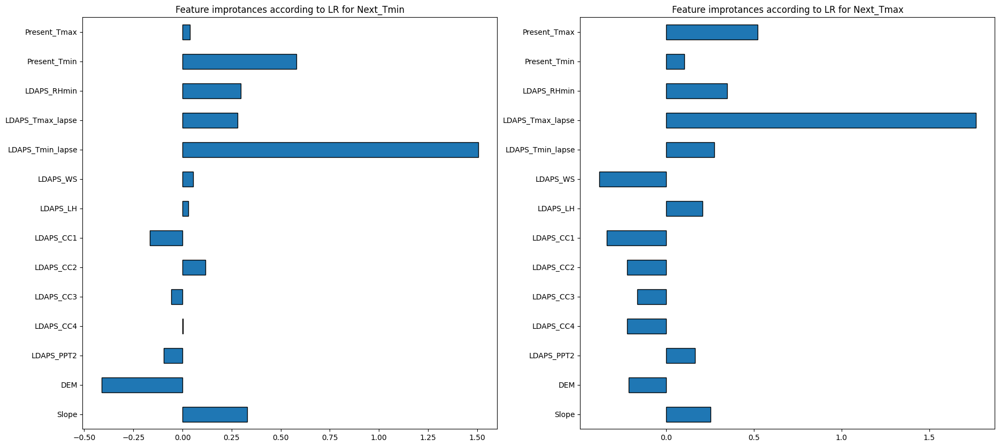

In [35]:
# Features selected by the feature selector
is_feat_selected = cv_LR.best_estimator_['transformer']['feature_selector'].get_support()
features_filtered = X_train.columns[~is_feat_selected]

# Feature importance
fig, ax = plt.subplots(1,2, figsize=(22,10))
for i, coef in enumerate(cv_LR.best_estimator_['LR'].coef_):
    # Loop over coef_ for every regressor (one regressor per target variable) and plot
    pd.Series(coef, index=X_train.columns[is_feat_selected]).plot(kind='barh', edgecolor='black', ax=ax[i])
    
    # Invert y-axis
    ax[i].invert_yaxis()

# Set titles
ax[0].set_title('Feature improtances according to LR for Next_Tmin')
ax[1].set_title('Feature improtances according to LR for Next_Tmax')

# Print selected features by the feature selector
print(f"Features filtered by the feature selector are:\n{features_filtered}")

### * Random Forest

In [36]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.multioutput import MultiOutputRegressor
from sklearn.compose import TransformedTargetRegressor

#### Training

In [37]:
%%time

# Hyper-parameters
params_RF = {
    'transformer__feature_selector__max_features': (13, 14),
    'RF__max_depth': (18, 20),
    'RF__max_features': (9, 11),
}

# Create the model pipeline
cv_RF = build_regression_pipeline(transformer_pipeline, 
                                  RandomForestRegressor(random_state=0),
                                  params=params_RF,
                                  regressor_name='RF')

# Fit the pipeline to training data
cv_RF.fit(X_train, y_train)

# Print pipeline and chosen parameters
display(cv_RF)
print(f'Parameters chosen by Hindcast validation:\n{cv_RF.best_params_}')

Fitting 3 folds for each of 8 candidates, totalling 24 fits
[CV 1/3] END RF__max_depth=18, RF__max_features=9, transformer__feature_selector__max_features=13;, score=0.590 total time=   0.6s
[CV 2/3] END RF__max_depth=18, RF__max_features=9, transformer__feature_selector__max_features=13;, score=0.683 total time=   1.2s
[CV 3/3] END RF__max_depth=18, RF__max_features=9, transformer__feature_selector__max_features=13;, score=0.831 total time=   1.8s
[CV 1/3] END RF__max_depth=18, RF__max_features=9, transformer__feature_selector__max_features=14;, score=0.531 total time=   0.6s
[CV 2/3] END RF__max_depth=18, RF__max_features=9, transformer__feature_selector__max_features=14;, score=0.679 total time=   1.2s
[CV 3/3] END RF__max_depth=18, RF__max_features=9, transformer__feature_selector__max_features=14;, score=0.830 total time=   1.8s
[CV 1/3] END RF__max_depth=18, RF__max_features=11, transformer__feature_selector__max_features=13;, score=0.585 total time=   0.7s
[CV 2/3] END RF__max_d

GridSearchCV(cv=<class '__main__.HindcastCV'>,
             estimator=Pipeline(steps=[('transformer',
                                        Pipeline(steps=[('scaler',
                                                         StandardScaler()),
                                                        ('feature_selector',
                                                         SelectFromModel(estimator=LinearRegression(),
                                                                         threshold=-inf))])),
                                       ('RF',
                                        RandomForestRegressor(random_state=0))]),
             param_grid={'RF__max_depth': (18, 20), 'RF__max_features': (9, 11),
                         'transformer__feature_selector__max_features': (13,
                                                                         14)},
             scoring=make_scorer(r2_score), verbose=3)

Parameters chosen by Hindcast validation:
{'RF__max_depth': 18, 'RF__max_features': 9, 'transformer__feature_selector__max_features': 13}
CPU times: user 36 s, sys: 6.51 s, total: 42.6 s
Wall time: 33.9 s


#### Evaluation

In [38]:
# Inference and evaluation
results_RF, ss_RF, _ = evaluate(cv_RF, X_test, y_test, ml_model_name='RF')

# Print results
display(results_RF)
print(f'Skill score for Next_Tmin: {ss_RF[0]:0.2f}%, Next_Tmax: {ss_RF[1]:0.2f}%')

Tmin                Tmax          
         LDAPS        RF     LDAPS        RF
Bias  0.630164  0.061842 -0.351262  0.373369
R2    0.757256  0.860528  0.649656  0.643194
RMSE  1.231043  0.933129  1.869568  1.886731

Skill score for Next_Tmin: 24.20%, Next_Tmax: -0.92%


#### Feature Importance

Features filtered by the feature selector are:
Index(['LDAPS_RHmax', 'LDAPS_CC3', 'LDAPS_PPT1', 'LDAPS_PPT3', 'LDAPS_PPT4',
       'lat', 'lon', 'Solar radiation'],
      dtype='object')


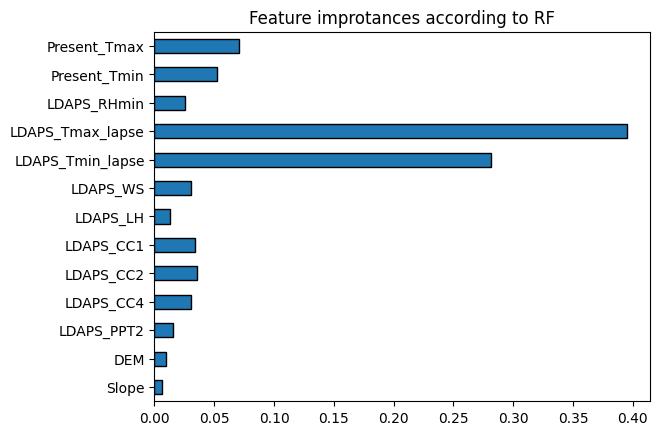

In [39]:
# Features selected by the feature selector
is_feat_selected = cv_RF.best_estimator_['transformer']['feature_selector'].get_support()
features_filtered = X_train.columns[~is_feat_selected]

# Feature importances
feat_imp = cv_RF.best_estimator_['RF'].feature_importances_

# Plot
ax = pd.Series(feat_imp, index=X_train.columns[is_feat_selected]).plot(kind='barh', edgecolor='black')

# Invert y-axis and set title
ax.invert_yaxis()
ax.set_title('Feature improtances according to RF')

# Print features selected by the feature selector
print(f"Features filtered by the feature selector are:\n{features_filtered}")

### * Gradient Boosting

In [40]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.multioutput import MultiOutputRegressor

#### Training

In [41]:
%%time 

# Hyper-parameters
params_GB = {
    'transformer__feature_selector__max_features': (13, 14),
    'multioutput_GB__estimator__learning_rate': (0.05, 0.1),
    'multioutput_GB__estimator__n_estimators': (50, 100)
}

# Create the model pipeline
cv_GB = build_regression_pipeline(transformer_pipeline, 
                                  MultiOutputRegressor(GradientBoostingRegressor(random_state=0)),
                                  params=params_GB,
                                  regressor_name='multioutput_GB')

# Fit the pipeline to training data
cv_GB.fit(X_train, y_train)

# Print pipeline and chosen parameters
display(cv_GB)
print(f'Parameters chosen by Hindcast validation:\n{cv_GB.best_params_}')

Fitting 3 folds for each of 8 candidates, totalling 24 fits
[CV 1/3] END multioutput_GB__estimator__learning_rate=0.05, multioutput_GB__estimator__n_estimators=50, transformer__feature_selector__max_features=13;, score=0.610 total time=   0.3s
[CV 2/3] END multioutput_GB__estimator__learning_rate=0.05, multioutput_GB__estimator__n_estimators=50, transformer__feature_selector__max_features=13;, score=0.660 total time=   0.6s
[CV 3/3] END multioutput_GB__estimator__learning_rate=0.05, multioutput_GB__estimator__n_estimators=50, transformer__feature_selector__max_features=13;, score=0.798 total time=   1.0s
[CV 1/3] END multioutput_GB__estimator__learning_rate=0.05, multioutput_GB__estimator__n_estimators=50, transformer__feature_selector__max_features=14;, score=0.586 total time=   0.3s
[CV 2/3] END multioutput_GB__estimator__learning_rate=0.05, multioutput_GB__estimator__n_estimators=50, transformer__feature_selector__max_features=14;, score=0.664 total time=   0.7s
[CV 3/3] END multiou

GridSearchCV(cv=<class '__main__.HindcastCV'>,
             estimator=Pipeline(steps=[('transformer',
                                        Pipeline(steps=[('scaler',
                                                         StandardScaler()),
                                                        ('feature_selector',
                                                         SelectFromModel(estimator=LinearRegression(),
                                                                         threshold=-inf))])),
                                       ('multioutput_GB',
                                        MultiOutputRegressor(estimator=GradientBoostingRegressor(random_state=0)))]),
             param_grid={'multioutput_GB__estimator__learning_rate': (0.05,
                                                                      0.1),
                         'multioutput_GB__estimator__n_estimators': (50, 100),
                         'transformer__feature_selector__max_features': (13,
                                                                         14)},
             scoring=make_scorer(r2_score), verbose=3)

Parameters chosen by Hindcast validation:
{'multioutput_GB__estimator__learning_rate': 0.1, 'multioutput_GB__estimator__n_estimators': 100, 'transformer__feature_selector__max_features': 13}
CPU times: user 28.4 s, sys: 6.78 s, total: 35.2 s
Wall time: 26.5 s


#### Evaluation

In [42]:
# Inference and evaluation
results_GB, ss_GB, _ = evaluate(cv_GB, X_test, y_test, ml_model_name='RF')

# Print results
display(results_GB)
print(f'Skill score for Next_Tmin: {ss_GB[0]:0.2f}%, Next_Tmax: {ss_GB[1]:0.2f}%')

Tmin                Tmax          
         LDAPS        RF     LDAPS        RF
Bias  0.630164  0.072357 -0.351262  0.388782
R2    0.757256  0.885221  0.649656  0.668662
RMSE  1.231043  0.846505  1.869568  1.818149

Skill score for Next_Tmin: 31.24%, Next_Tmax: 2.75%


#### Feature Importance

Features filtered by the feature selector are:
Index(['LDAPS_RHmax', 'LDAPS_CC3', 'LDAPS_PPT1', 'LDAPS_PPT3', 'LDAPS_PPT4',
       'lat', 'lon', 'Solar radiation'],
      dtype='object')


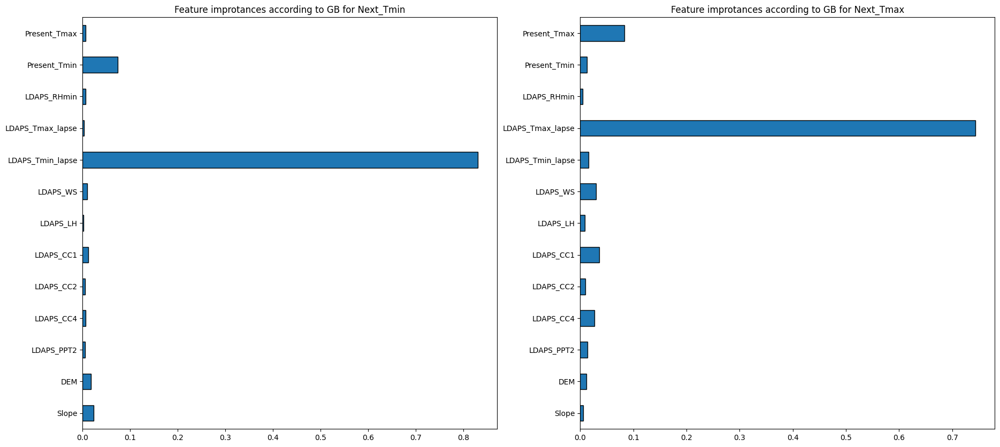

In [43]:
# Features selected by the feature selector
is_feat_selected = cv_GB.best_estimator_['transformer']['feature_selector'].get_support()
features_filtered = X_train.columns[~is_feat_selected]

# Feature importance
fig, ax = plt.subplots(1, 2, figsize=(22, 10))
for i, reg in enumerate(cv_GB.best_estimator_['multioutput_GB'].estimators_):
    # Loop over every regressor, get feature importance and plot
    feat_imp = reg.feature_importances_
    pd.Series(feat_imp, index=X_train.columns[is_feat_selected]).plot(kind='barh', edgecolor='black', ax=ax[i])
    
    # Invert y-axis
    ax[i].invert_yaxis()

# Set titles
ax[0].set_title('Feature improtances according to GB for Next_Tmin')
ax[1].set_title('Feature improtances according to GB for Next_Tmax')

# Print features selected by the feature selector
print(f"Features filtered by the feature selector are:\n{features_filtered}")

### * Support Vector Regression

In [44]:
from sklearn.svm import SVR
from sklearn.multioutput import MultiOutputRegressor

#### Training

In [45]:
%%time

# Hyper-parameters
params_SVR = {
    'transformer__feature_selector__max_features': (13, 14),
    'multioutput_SVR__estimator__C': np.logspace(-1, 1, 3),
    'multioutput_SVR__estimator__epsilon': (0.05, 0.1)
}

# Create the model pipeline
cv_SVR = build_regression_pipeline(transformer_pipeline, 
                                   MultiOutputRegressor(SVR(kernel='linear')),
                                   params=params_SVR,
                                   regressor_name='multioutput_SVR')

# Fit the pipeline to training data
cv_SVR.fit(X_train, y_train)

# Print pipeline and chosen parameters
display(cv_SVR)
print(f'Parameters chosen by Hindcast validation:\n{cv_SVR.best_params_}')

Fitting 3 folds for each of 12 candidates, totalling 36 fits
[CV 1/3] END multioutput_SVR__estimator__C=0.1, multioutput_SVR__estimator__epsilon=0.05, transformer__feature_selector__max_features=13;, score=0.631 total time=   0.2s
[CV 2/3] END multioutput_SVR__estimator__C=0.1, multioutput_SVR__estimator__epsilon=0.05, transformer__feature_selector__max_features=13;, score=0.721 total time=   0.7s
[CV 3/3] END multioutput_SVR__estimator__C=0.1, multioutput_SVR__estimator__epsilon=0.05, transformer__feature_selector__max_features=13;, score=0.862 total time=   1.4s
[CV 1/3] END multioutput_SVR__estimator__C=0.1, multioutput_SVR__estimator__epsilon=0.05, transformer__feature_selector__max_features=14;, score=0.625 total time=   0.2s
[CV 2/3] END multioutput_SVR__estimator__C=0.1, multioutput_SVR__estimator__epsilon=0.05, transformer__feature_selector__max_features=14;, score=0.723 total time=   0.7s
[CV 3/3] END multioutput_SVR__estimator__C=0.1, multioutput_SVR__estimator__epsilon=0.05,

GridSearchCV(cv=<class '__main__.HindcastCV'>,
             estimator=Pipeline(steps=[('transformer',
                                        Pipeline(steps=[('scaler',
                                                         StandardScaler()),
                                                        ('feature_selector',
                                                         SelectFromModel(estimator=LinearRegression(),
                                                                         threshold=-inf))])),
                                       ('multioutput_SVR',
                                        MultiOutputRegressor(estimator=SVR(kernel='linear')))]),
             param_grid={'multioutput_SVR__estimator__C': array([ 0.1,  1. , 10. ]),
                         'multioutput_SVR__estimator__epsilon': (0.05, 0.1),
                         'transformer__feature_selector__max_features': (13,
                                                                         14)},
             scoring=make_scorer(r2_score), verbose=3)

Parameters chosen by Hindcast validation:
{'multioutput_SVR__estimator__C': 0.1, 'multioutput_SVR__estimator__epsilon': 0.05, 'transformer__feature_selector__max_features': 13}
CPU times: user 1min 48s, sys: 10.2 s, total: 1min 58s
Wall time: 1min 45s


#### Evaluation

In [46]:
# Inference and evaluation
results_SVR, ss_SVR, _ = evaluate(cv_SVR, X_test, y_test, ml_model_name='RF')

# Print results
display(results_SVR)
print(f'Skill score for Next_Tmin: {ss_SVR[0]:0.2f}%, Next_Tmax: {ss_SVR[1]:0.2f}%')

Tmin                Tmax          
         LDAPS        RF     LDAPS        RF
Bias  0.630164  0.167316 -0.351262  0.355985
R2    0.757256  0.862534  0.649656  0.710798
RMSE  1.231043  0.926396  1.869568  1.698613

Skill score for Next_Tmin: 24.75%, Next_Tmax: 9.14%


#### Feature Importance

Features filtered by the feature selector are:
Index(['LDAPS_RHmax', 'LDAPS_CC3', 'LDAPS_PPT1', 'LDAPS_PPT3', 'LDAPS_PPT4',
       'lat', 'lon', 'Solar radiation'],
      dtype='object')


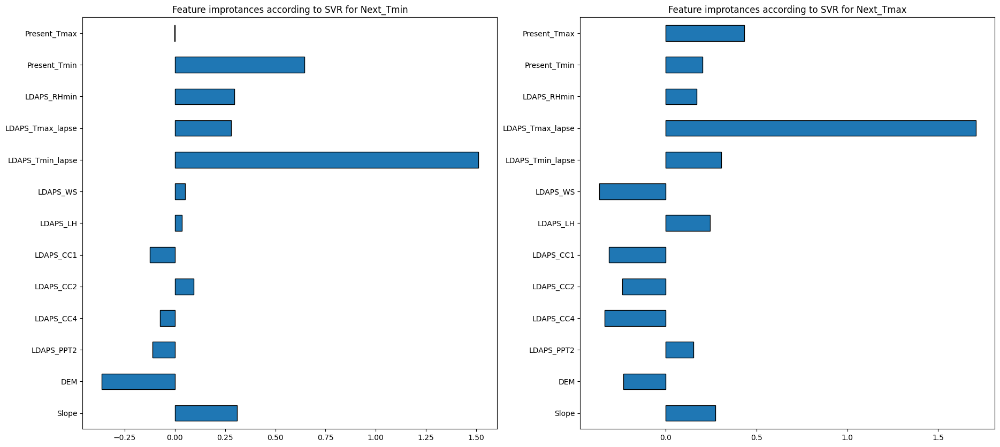

In [47]:
# Features selected by the feature selector
is_feat_selected = cv_SVR.best_estimator_['transformer']['feature_selector'].get_support()
features_filtered = X_train.columns[~is_feat_selected]

# Feature importance
fig, ax = plt.subplots(1, 2, figsize=(22, 10))
for i, reg in enumerate(cv_SVR.best_estimator_['multioutput_SVR'].estimators_):
    # Loop over every regressor, get feature importance and plot
    feat_imp = reg.coef_[0]
    pd.Series(feat_imp, index=X_train.columns[is_feat_selected]).plot(kind='barh', edgecolor='black', ax=ax[i])
    
    # Invert y-axis
    ax[i].invert_yaxis()

# Set titles
ax[0].set_title('Feature improtances according to SVR for Next_Tmin')
ax[1].set_title('Feature improtances according to SVR for Next_Tmax')

# Print selected features by the feature selector
print(f"Features filtered by the feature selector are:\n{features_filtered}")

### * Multi-Layer Perceptron

In [48]:
import tensorflow as tf

from tensorflow.keras import layers, losses, metrics, optimizers, callbacks
from scikeras.wrappers import KerasRegressor

# Set random seeds for reproducibility
np.random.seed(42)
tf.random.set_seed(42)

In [49]:
# Callback to print model parameters at the end of every training in the GridSearchCV
class ParamPrintingCallback(callbacks.Callback):
    
    def on_train_end(self, logs=None):
        conf = self.model.get_config()
        print(f'Number of layers: {len(self.model.layers)}') 
        print(f'Learning rate: {self.model.optimizer.learning_rate.numpy(): 0.5f}')
        print(f'Kernel initializer: {conf["layers"][1]["config"]["kernel_initializer"]["class_name"]}') 
        print(f'Kernel regularizer: {conf["layers"][1]["config"]["kernel_regularizer"]["class_name"]}')

#### Model architectures

In [50]:
def mlp_regressor1(input_shape=(21,), lr=0.001, kernel_init='glorot_uniform', kernel_reg='l1'):
    model = tf.keras.models.Sequential()
    
    # Input
    model.add(tf.keras.Input(shape=input_shape))
    
    # Hidden layers
    model.add(layers.Dense(10, activation='relu', kernel_initializer=kernel_init, kernel_regularizer=kernel_reg))
    model.add(layers.Dense(7, activation='relu', kernel_initializer=kernel_init, kernel_regularizer=kernel_reg))

    # Output
    model.add(layers.Dense(2, kernel_initializer=kernel_init, kernel_regularizer=kernel_reg))
    
    # Compile model
    model.compile(optimizer=optimizers.Adam(learning_rate=lr),
                  loss=losses.MeanSquaredError(),
                  metrics=[metrics.MeanSquaredError()])
        
    return model


def mlp_regressor2(input_shape=(21,), lr=0.001, kernel_init='glorot_uniform', kernel_reg='l1'):
    model = tf.keras.models.Sequential()
    
    # Input
    model.add(tf.keras.Input(shape=input_shape))
    
    # Hidden layers
    model.add(layers.Dense(11, activation='relu', kernel_initializer=kernel_init, kernel_regularizer=kernel_reg))
    model.add(layers.Dense(9, activation='relu', kernel_initializer=kernel_init, kernel_regularizer=kernel_reg))

    # Output
    model.add(layers.Dense(2, kernel_initializer=kernel_init, kernel_regularizer=kernel_reg))
    
    # Compile model
    model.compile(optimizer=optimizers.Adam(learning_rate=lr),
                  loss=losses.MeanSquaredError(),
                  metrics=[metrics.MeanSquaredError()])
        
    return model


def mlp_regressor3(input_shape=(21,), lr=0.001, kernel_init='glorot_uniform', kernel_reg='l1'):
    model = tf.keras.models.Sequential()
    
    # Input
    model.add(tf.keras.Input(shape=input_shape))
    
    # Hidden layers
    model.add(layers.Dense(22, activation='relu', kernel_initializer=kernel_init, kernel_regularizer=kernel_reg))
    model.add(layers.Dense(19, activation='relu', kernel_initializer=kernel_init, kernel_regularizer=kernel_reg))

    # Output
    model.add(layers.Dense(2, kernel_initializer=kernel_init, kernel_regularizer=kernel_reg))
    
    # Compile model
    model.compile(optimizer=optimizers.Adam(learning_rate=lr),
                  loss=losses.MeanSquaredError(),
                  metrics=[metrics.MeanSquaredError()])
        
    return model


def mlp_regressor4(input_shape=(21,), lr=0.001, kernel_init='glorot_uniform', kernel_reg='l1'):
    model = tf.keras.models.Sequential()
    
    # Input
    model.add(tf.keras.Input(shape=input_shape))
    
    # Hidden layers
    model.add(layers.Dense(15, activation='relu', kernel_initializer=kernel_init, kernel_regularizer=kernel_reg))
    model.add(layers.Dense(11, activation='relu', kernel_initializer=kernel_init, kernel_regularizer=kernel_reg))
    model.add(layers.Dense(7, activation='relu', kernel_initializer=kernel_init, kernel_regularizer=kernel_reg))

    # Output
    model.add(layers.Dense(2, kernel_initializer=kernel_init, kernel_regularizer=kernel_reg))
    
    # Compile model
    model.compile(optimizer=optimizers.Adam(learning_rate=lr),
                  loss=losses.MeanSquaredError(),
                  metrics=[metrics.MeanSquaredError()])
        
    return model

#### Training

##### Note: The run time of this cell is around 8 minutes 

In [51]:
%%time

# Hyper-parameters, feature-selector deactivated
params_MLP = {
    'MLP__model': [mlp_regressor2(lr=lr, kernel_init='he_normal', kernel_reg='l1') for lr in [2e-4, 2.5e-4]]
}

# Create the model pipeline using KerasRegressor wrapper
cv_MLP = build_regression_pipeline(transformer_pipeline, 
                                   KerasRegressor(batch_size=7000,
                                                  epochs=50000,
                                                  verbose=0, 
                                                  callbacks=[ParamPrintingCallback]),
                                   params=params_MLP,
                                   regressor_name='MLP')

# Fit the pipeline to training data
cv_MLP.fit(X_train, y_train)

# Display pipeline and MLP
display(cv_MLP)
display(cv_MLP.best_estimator_[1].model_.summary())

# Print chosen parameters
print(f'Learning Rate: {cv_MLP.best_estimator_[1].model_.optimizer.learning_rate.numpy(): 0.5f}')

2022-08-25 09:31:05.373188: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


Fitting 3 folds for each of 2 candidates, totalling 6 fits
INFO:tensorflow:Assets written to: ram:///tmp/tmpgjtcj3z6/assets
Number of layers: 3
Learning rate:  0.00020
Kernel initializer: HeNormal
Kernel regularizer: L1
[CV 1/3] END MLP__model=<keras.engine.sequential.Sequential object at 0x7fc11ae94460>;, score=0.480 total time= 1.1min
INFO:tensorflow:Assets written to: ram:///tmp/tmpg2u8ba5d/assets
Number of layers: 3
Learning rate:  0.00020
Kernel initializer: HeNormal
Kernel regularizer: L1
[CV 2/3] END MLP__model=<keras.engine.sequential.Sequential object at 0x7fc11ae94460>;, score=0.615 total time= 1.1min
INFO:tensorflow:Assets written to: ram:///tmp/tmpdtg623f7/assets
Number of layers: 3
Learning rate:  0.00020
Kernel initializer: HeNormal
Kernel regularizer: L1
[CV 3/3] END MLP__model=<keras.engine.sequential.Sequential object at 0x7fc11ae94460>;, score=0.843 total time= 1.2min
INFO:tensorflow:Assets written to: ram:///tmp/tmpo279l78m/assets
Number of layers: 3
Learning rate:  

GridSearchCV(cv=<class '__main__.HindcastCV'>,
             estimator=Pipeline(steps=[('transformer',
                                        Pipeline(steps=[('scaler',
                                                         StandardScaler()),
                                                        ('feature_selector',
                                                         SelectFromModel(estimator=LinearRegression(),
                                                                         threshold=-inf))])),
                                       ('MLP',
                                        KerasRegressor(batch_size=7000, callbacks=[<class '__main__.ParamPrintingCallback'>], epochs=50000, verbose=0))]),
             param_grid={'MLP__model': [<keras.engine.sequential.Sequential object at 0x7fc11ae94460>,
                                        <keras.engine.sequential.Sequential object at 0x7fc111aa7c10>]},
             scoring=make_scorer(r2_score), verbose=3)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 11)                242       
                                                                 
 dense_1 (Dense)             (None, 9)                 108       
                                                                 
 dense_2 (Dense)             (None, 2)                 20        
                                                                 
Total params: 370
Trainable params: 370
Non-trainable params: 0
_________________________________________________________________


None

Learning Rate:  0.00020
CPU times: user 13min 49s, sys: 1min 11s, total: 15min
Wall time: 8min 9s


#### Evaluation

In [52]:
# Inference and evaluation
results_MLP, ss_MLP, _ = evaluate(cv_MLP, X_test, y_test, ml_model_name='MLP')

# Print results
display(results_MLP)
print(f'Skill score for Next_Tmin: {ss_MLP[0]:0.2f}%, Next_Tmax: {ss_MLP[1]:0.2f}%')

Tmin                Tmax          
         LDAPS       MLP     LDAPS       MLP
Bias  0.630164  0.064566 -0.351262  0.256959
R2    0.757256  0.883981  0.649656  0.686153
RMSE  1.231043  0.851067  1.869568  1.769510

Skill score for Next_Tmin: 30.87%, Next_Tmax: 5.35%


### * Multi-Model Ensemble

In [53]:
from sklearn.base import BaseEstimator, RegressorMixin, clone
from sklearn.utils.validation import check_array, check_is_fitted

In [54]:
class MME(BaseEstimator, RegressorMixin):
    """A class that implements Multi-Model ensemble learning given a collection of already-trained models. 
    
    The function combines the predictions of the given models and return a final prediction using either of 
    two methods:
        1. Take a uniform average of the predictions of all the given models
        2. Use a given estimator where the input to this estimator is the predictions of all the given models 
        and learna model to combine them. The model is learnt on the training data given to the fit method.
        
    The class inherits from BaseEstimator and RegressorMixin
    
    """
    
    def __init__(self, models: list[RegressorMixin], estimator: RegressorMixin=None):
        """init
        
        Args:
            models: a list of already-train models
            estimator: a model that is to be trained to combine the models predictions. If None, simple
            averaging is applied. 
        
        """
        
        self.models = models
        self.estimator = estimator
        
        if self.estimator is not None:            
            self.estimator = clone(estimator)
        
    def fit(self, X: pd.DataFrame, y: pd.DataFrame) -> RegressorMixin:  
        """fit method that fits the given estimator. If estimator is None, this method has no effect.
        
        Args:
            X: independent variabels of train data
            y: target variables of train data
            
        Returns: instance of this class that is alreay trained
        
        """
        # If no estimator is given, no training is required
        if self.estimator is None:
            return self
        
        # Apply inference of models on training data to generate output
        pred = np.column_stack([model.predict(X) for model in self.models])
        
        # Standaradize the predictions
        self.scaler_ = StandardScaler()
        pred = self.scaler_.fit_transform(pred)        
        
        # Fit the estimator on the predictions and the training dependent variables
        self.estimator = self.estimator.fit(pred, y)
        
        return self
    
    def predict(self, X: pd.DataFrame) -> np.ndarray:
        """predict method that generates predictions for a given test data
        
        Args:
            X: independent variables of test data
            
        Returns: Next_Tmin & Next_Tmax for every sample in the data
        
        """
        
        # Apply simple averaging if estimator is None
        if self.estimator is None:
            pred = np.zeros((X.shape[0], 2))
        
            for model in self.models:
                pred += model.predict(X)

            mean_pred = pred / len(self.models)
        
            return mean_pred 
        
        # Check if fit was called
        check_is_fitted(self)
        
        # Get output of the trained models on the test data and generate initial predicitons
        pred = np.column_stack([model.predict(X) for model in self.models])

        # Standardize the prediciton using the fitted scaler
        pred = self.scaler_.transform(pred)
        
        # Use fitted estimator to generate final predictions
        pred = self.estimator.predict(pred)
        
        return pred

#### Training

In [55]:
# Create MME instance using simple averaging, Random Forest is excluded
models = [cv_LR, cv_SVR, cv_MLP, cv_GB]
cv_MME = MME(models=models, estimator=None).fit(X_train, y_train)

#### Evaluation

In [56]:
df, ss, _ = evaluate(cv_MME, X_test, y_test)

display(df)
print(ss)

Tmin                Tmax          
         LDAPS     model     LDAPS     model
Bias  0.630164  0.095674 -0.351262  0.342656
R2    0.757256  0.883288  0.649656  0.709880
RMSE  1.231043  0.853605  1.869568  1.701309

[30.65999956  8.99987828]


## Results

### Plot Functions

In [57]:
from scipy.stats import gaussian_kde

In [58]:
def plot_forecasts(models: list[RegressorMixin],
                   X_test: pd.DataFrame, 
                   y_test: pd.DataFrame, 
                   names: list[str],
                   temp: str = 'Tmin'):
    
    """Function to plot forecasted temperatures vs. oberved temperatures for every given model. 
    
    The function generate the plots for either Tmin or Tmax specified by temp
    
    Args:
        models: a list of already-trained models
        X_test: test independent variables
        y_test: test ground truth target variables
        names: a list of the names of the given models
        temp: Tmin or Tmax to define for which pediction the plots are generated
    
    """
    
    assert len(names) == len(models)
    
    # Temperature index
    temp_idx = 0 if temp == 'Tmin' else 1
    
    # x-lim, y-lim
    if temp == 'Tmin':
        xlim, ylim = (10, 30), (10, 30)
    else:
        xlim, ylim = (15, 40), (15, 40)

    fig = plt.figure(figsize=(10,20))
    for i, model in enumerate(models):
        ax = plt.subplot(4, 2, i+1)
        
        # Predict and evaluate
        scores, ss, y_pred = evaluate(model, X_test, y_test)
        
        # Model scores
        bias, r2, rmse = scores[temp].drop('LDAPS', axis=1).values

        # x-axis, y-axis
        x, y = y_pred[:, temp_idx], y_test.iloc[:, temp_idx]
        
        # Fit gaussian for density visualization
        xy = np.vstack([x, y])
        z = gaussian_kde(xy)(xy)
        
        # Fit regression lines for model predictions
        m_ml, a_ml = np.polyfit(x, y, deg=1)
        
        # Plot data
        ax.scatter(x, y, c=z, s=7)
        
        # Plot regression lines
        xseq = np.linspace(xlim[0], xlim[1], num=X_test.shape[0])
        ax.plot(xseq, a_ml + m_ml * xseq, color='k', lw=1, label='ML Model Forecast')
        ax.axline((xlim[0], xlim[0]), (ylim[1], ylim[1]), color='k', lw=1, ls="--")
        
        # x-label, y-label
        ax.set_xlabel(' '.join(['Forecasted Air Temperature for', temp, '(C°)']), fontsize=7)
        ax.set_ylabel(' '.join(['Observed Air Temperature for', temp, '(C°)']), fontsize=7)

        # xlim, ylim
        ax.set_xlim(xlim[0], xlim[1])
        ax.set_ylim(ylim[0], ylim[1])
            
        # Write scores
        if temp == 'Tmin':        
            ax.text(23, 13.5, f"R2 = {r2[0]:.2f}")
            ax.text(23, 12.5, f"Bias = {bias[0]:.2f}C°")
            ax.text(23, 11.5, f"RMSE = {rmse[0]:.2f}C°")
            ax.text(23, 10.5, f"SS = {ss[temp_idx]:.2f}%")
        else:
            ax.text(32, 19, f"R2 = {r2[0]:.2f}")
            ax.text(32, 18, f"Bias = {bias[0]:.2f}C°")
            ax.text(32, 17, f"RMSE = {rmse[0]:.2f}C°")
            ax.text(32, 16, f"SS = {ss[temp_idx]:.2f}%")
            
        # Title
        ax.set_title(f"{names[i]} Forecast for {temp}", fontsize=10) 
        

def plot_stations_ss(models: list[RegressorMixin],
                     X_test: pd.DataFrame,
                     y_test: pd.DataFrame, 
                     names: list[str],
                     temp: str = 'Tmin',
                     bar_width: float = 0.2):
    
    """Function to plot skill scores for every weather station.
    
    The function generate the plots for either Tmin or Tmax specified by temp
    
    Args:
        models: a list of already-trained models
        X_test: test independent variables
        y_test: test ground truth target variables
        names: a list of the names of the given models
        temp: Tmin or Tmax to define for which pediction the plots are generated
        bar_width: width of every bar in the bar plots
    
    """
    
    # Temperature index
    temp_idx = 0 if temp == 'Tmin' else 1
    
    # Group test dataset by every station 
    stations_groups = X_test.groupby(X_test.index.get_level_values(1)).size()
    
        
    # LDAPS predictions
    y_pred_ldaps = X_test[['LDAPS_Tmin_lapse', 'LDAPS_Tmax_lapse']]

    # x-sequence scaled
    xseq = np.arange(stations_groups.shape[0], dtype=float) * 1.5
    
    fig = plt.figure(figsize=(15,10))
    for i, model in enumerate(models):
        
        # Skill scores per station
        ss_stations = []
        
        # Predict using current model
        _, _, y_pred_ml = evaluate(model, X_test, y_test)
        
        for station, _ in stations_groups.items():
            station_mask = X_test.index.get_level_values(1) == station
            
            # Calculate skill score for current model on current station, choose temp result
            ss_stations.append(ss_metric(y_test[station_mask],
                                         y_pred_ldaps[station_mask],
                                         y_pred_ml[station_mask])[temp_idx])
            
        # Plot current model results into an adjusted position
        plt.bar(xseq + i*bar_width, ss_stations, width=bar_width, align='center', label=names[i])
        
    # xticks
    plt.xticks(xseq + bar_width*(len(models)/2), 
               [f'S{j+1}' for j in np.arange(stations_groups.shape[0])])
    
    # Adjust x-axis position
    plt.gca().spines['bottom'].set_position('zero')
    
    # Titles
    plt.title(f'Skill Scores for Machine Learning Models Per Weather Station for {temp}')
    plt.xlabel('Station Number')
    plt.ylabel('Skill Score (%)')
    
    # Legend
    plt.legend()

### Forecasted Tmin

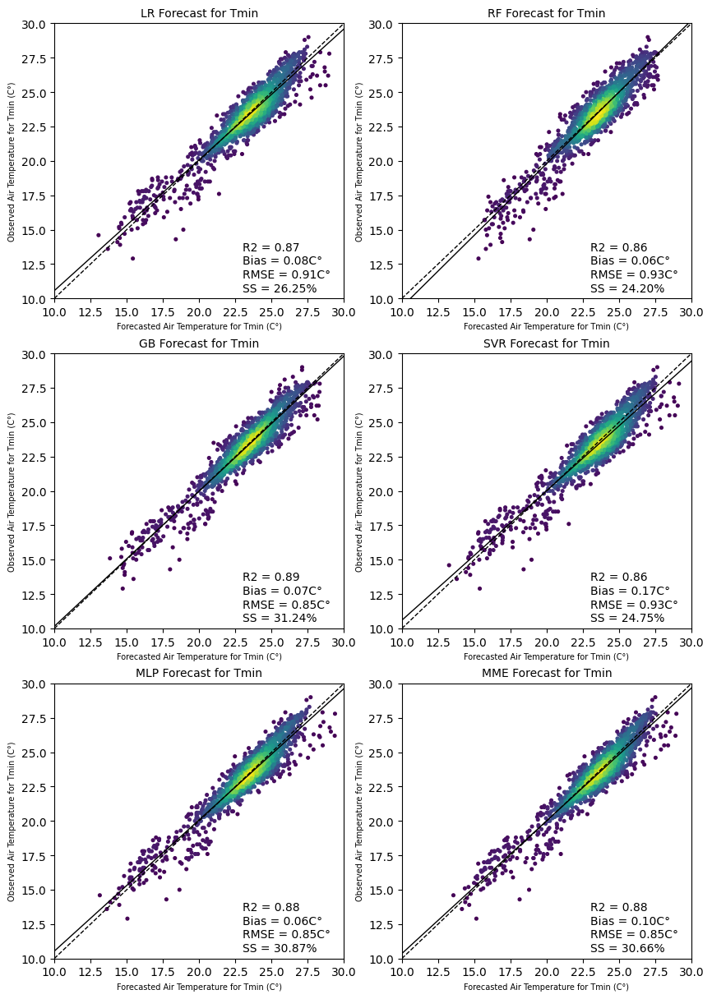

In [59]:
plot_forecasts([cv_LR, cv_RF, cv_GB, cv_SVR, cv_MLP, cv_MME], X_test, y_test,
               names=['LR', 'RF', 'GB', 'SVR', 'MLP', 'MME'], temp='Tmin')

### Forecasted Tmax

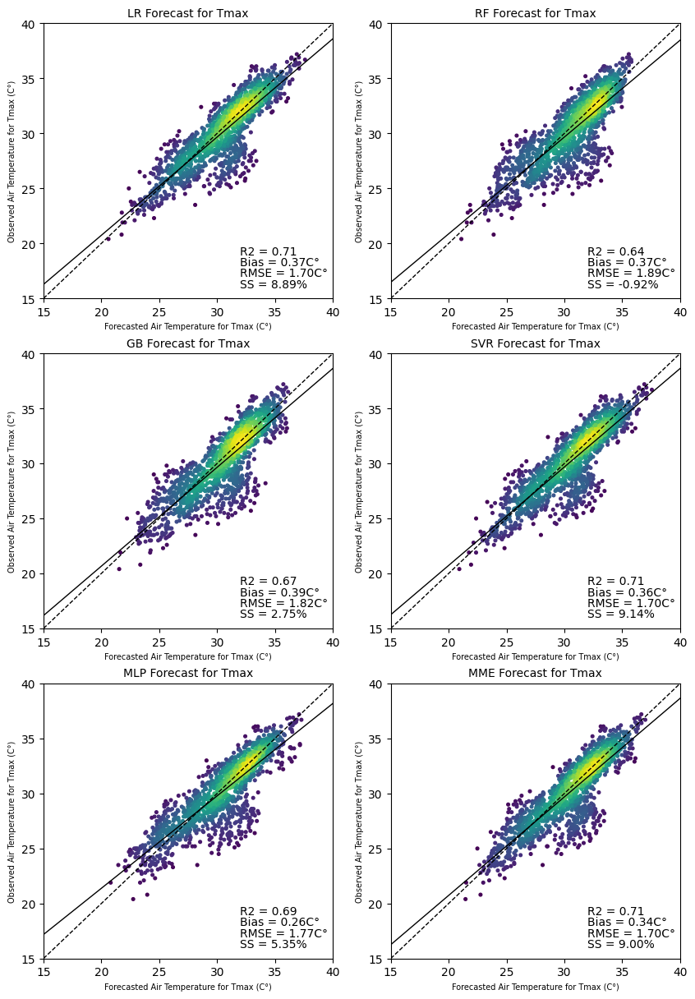

In [60]:
plot_forecasts([cv_LR, cv_RF, cv_GB, cv_SVR, cv_MLP, cv_MME], X_test, y_test,
               names=['LR', 'RF', 'GB', 'SVR', 'MLP', 'MME'], temp='Tmax')

### Skill Score Per Station for Tmin

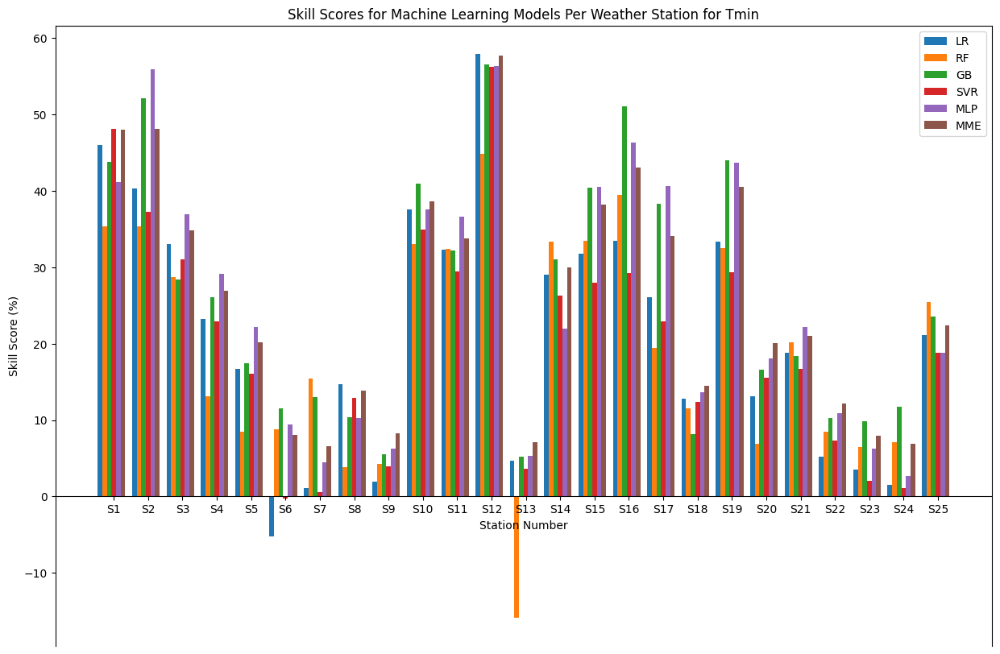

In [61]:
plot_stations_ss([cv_LR, cv_RF, cv_GB, cv_SVR, cv_MLP, cv_MME], X_test, y_test, 
                names=['LR', 'RF', 'GB', 'SVR', 'MLP', 'MME'], temp='Tmin')

### Skill Score Per Station for Tmax

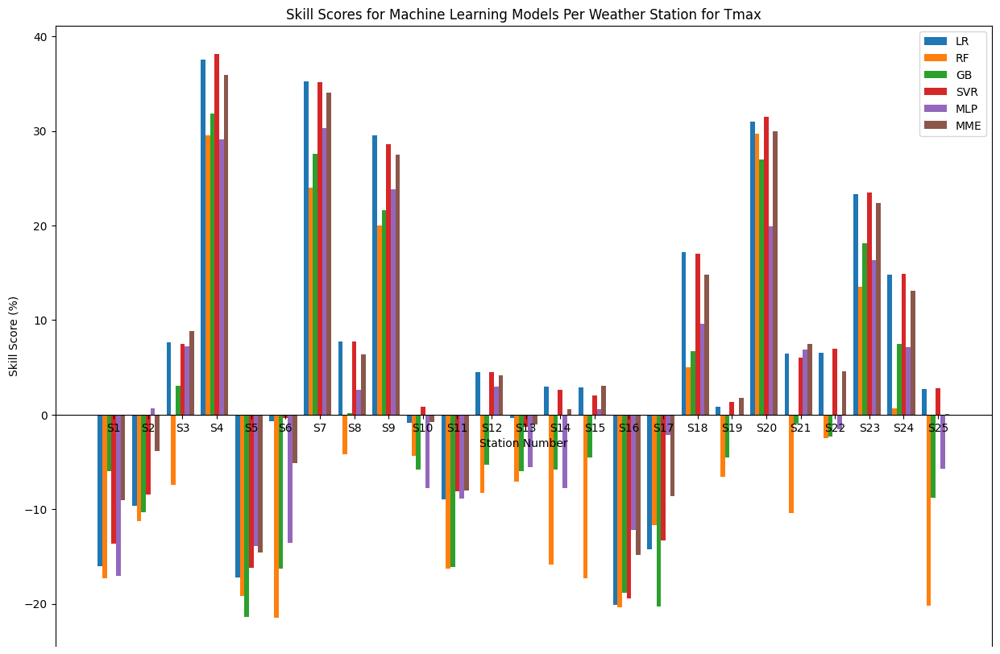

In [62]:
plot_stations_ss([cv_LR, cv_RF, cv_GB, cv_SVR, cv_MLP, cv_MME], X_test, y_test, 
                names=['LR', 'RF', 'GB', 'SVR', 'MLP', 'MME'], temp='Tmax')